## Pre-dataset
TFT is a videogame created by Riot Games, Inc. based on 2 previously existing videogames named Autochess (from which the logic of the game is derived) and League of Legends (from which the characters are derived).
The game is a round-based game, in which each round a player confronts another player using a combination of characters which may or may not have some form of synergy to help those same pieces defeat the adversary's pieces. Each game there are a total of 8 players, going up against each other.
While all start with the same 100 points and losing these points for each match they lose (points lost varies based on different factors), the goal is to be the last one standing.

## Top TFT Players
The dataset consists of information on players from 4 separate regions: EUW (Europe West), EUN (Europe Northeast), NA (North America) and KR (Korea).
The information we get from each player is the following:
- summonerName: name to identify the player, unique for each
- tier: The name of their rank (Master < Grandmaster < Challenger)
- regionName: The server/region they play in (see above)
- leaguePoints (LP): the points they have accumulated throughout the matches
- wins: the amount of times they have found themselves in 1st place
- losses: every game they are not in 1st place
- veteran: whether they have played 100+ games in the same tier
- inactive: whether or not they are still active
- freshBlood: whether they are new to the tier
- hotStreak: whether they have won 3+ matches in a row

### Further information
The dataset has information from August until November 2022, because the game goes through "seasons" where the points of each player is reset and they are forced to start from a lower point compared to where they ended in the previous season. What does this mean for our dataset?
- everyone who ended the last season in the top ranks will start pretty much from the same point
- not everyone who is in this dataset ended in a similar tier last season
- although the previous 2 statements are true, it is fair to say that unless someone stopped playing, most (if not all) players that managed to finish the set in these top 3 tiers are still in one of these tiers

In [1]:
pwd

'C:\\Users\\macac\\SecureSafe\\Private Safe\\SUPSI\\5th Semester\\Data Science\\project'

In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

tft = pd.read_json("TFT/TFT.json", encoding = "UTF-16")

if 'summonerId' in tft.columns:
    del tft["summonerId"]

#modify regionNames to more understandable names
tft = tft.replace('KR', 'Korea') 
tft = tft.replace('EUN', 'Europe Northeast') 
tft = tft.replace('EUW', 'Europe West') 
tft = tft.replace('NA', 'North America') 

In [3]:
tft

,summonerName,tier,regionName,leaguePoints,rank,wins,losses,veteran,inactive,freshBlood,hotStreak
0,Op11No1,CHALLENGER,Europe Northeast,846,I,108,41,False,False,False,False
1,Abo Sreee3,CHALLENGER,Europe Northeast,1108,I,327,193,True,False,False,False
2,Piterko,CHALLENGER,Europe Northeast,1010,I,91,54,False,False,False,False
3,6Dot,CHALLENGER,Europe Northeast,933,I,202,136,True,False,False,False
4,Daisan,CHALLENGER,Europe Northeast,749,I,147,117,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...
54361,ê°ë§Œìž,MASTER,Korea,456,I,85,91,False,False,False,False
54362,Willa,MASTER,Korea,16,I,109,94,True,False,False,False
54363,Jegnit,MASTER,Korea,0,I,57,44,False,False,False,False
54364,ì¿ íž›,MASTER,Korea,0,I,227,218,True,False,False,False


## Changes to the dataset
- removed the 'rank' column, seeing as it is irrelevant and the same for every player in the dataset.
- added the amount of games played, which is the some of wins and losses.
- added win rate column = wins/gamesPlayed

In [4]:
if 'rank' in tft.columns:
    del tft['rank']
if not 'gamesPlayed' in tft.columns:
    tft["gamesPlayed"] = tft["wins"] + tft["losses"]
if not 'winRate' in tft.columns:
    tft["winRate"] = tft["wins"]/tft["gamesPlayed"]*100
tft

,summonerName,tier,regionName,leaguePoints,wins,losses,veteran,inactive,freshBlood,hotStreak,gamesPlayed,winRate
0,Op11No1,CHALLENGER,Europe Northeast,846,108,41,False,False,False,False,149,72.483221
1,Abo Sreee3,CHALLENGER,Europe Northeast,1108,327,193,True,False,False,False,520,62.884615
2,Piterko,CHALLENGER,Europe Northeast,1010,91,54,False,False,False,False,145,62.758621
3,6Dot,CHALLENGER,Europe Northeast,933,202,136,True,False,False,False,338,59.763314
4,Daisan,CHALLENGER,Europe Northeast,749,147,117,False,False,False,False,264,55.681818
...,...,...,...,...,...,...,...,...,...,...,...,...
54361,ê°ë§Œìž,MASTER,Korea,456,85,91,False,False,False,False,176,48.295455
54362,Willa,MASTER,Korea,16,109,94,True,False,False,False,203,53.694581
54363,Jegnit,MASTER,Korea,0,57,44,False,False,False,False,101,56.435644
54364,ì¿ íž›,MASTER,Korea,0,227,218,True,False,False,False,445,51.011236


## Korean domination
Korea has the lead when it comes to number of players, seeing as only a small percentage of players can actually get to the top of the ranks, this is a reflection of how big of a game this is in Korea compared to other regions.

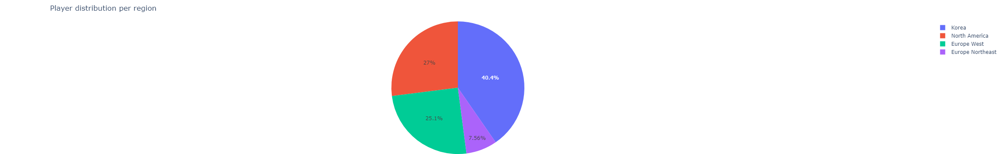

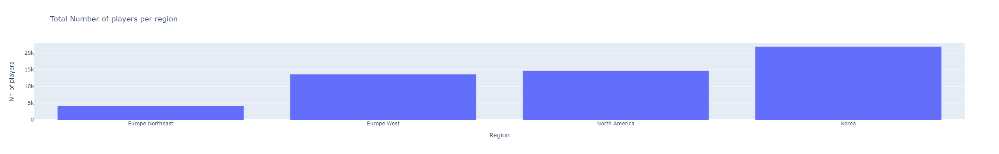

In [5]:
grandChallengers = tft[tft["tier"] != "MASTER"]

counts = make_subplots(rows = 1, cols = 3)
player_distribution_pie = px.pie(tft, names='regionName', title = "Player distribution per region")
player_distribution_hist = px.histogram(tft, x="regionName", title='Total Number of players per region')
player_distribution_hist.update_layout(yaxis=dict(title='Nr. of players'), xaxis=dict(title='Region'))

player_distribution_pie.update_layout(margin=dict(t=50, b=0, l=0, r=50))

player_distribution_pie.show()
player_distribution_hist.show()

## Korean domination - pt. 2
The aforementioned domination is also seen in the amount of players who have 0 points.
It is interesting to see that half of the players from each region only have 0 points, it is hard to conclude the reason as to why this is, it could be that some have decided to stop playing, some might no longer be interested in winning or there might even be a possibility that it is simply too difficult for them to increase their point score.

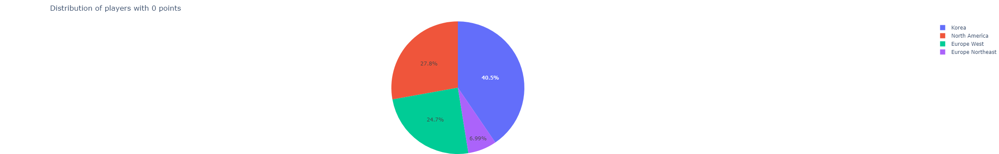

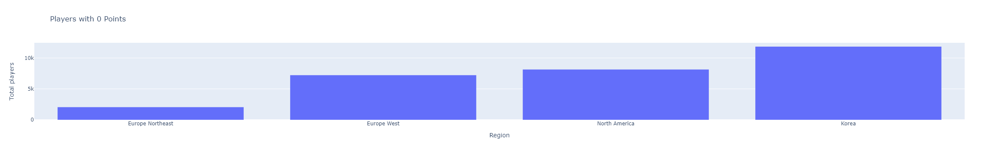

In [6]:
zero_points_players = tft[tft["leaguePoints"] == 0]
zero_points_pie = px.pie(zero_points_players, names='regionName', title='Distribution of players with 0 points')
zero_points_hist = px.histogram(zero_points_players, x="regionName", title="Players with 0 Points", labels = {"regionName":"Region"})

zero_points_hist.update_layout(yaxis=dict(title="Total players"))
zero_points_pie.update_layout(margin=dict(t=50, b=0, l=0, r=50))

zero_points_pie.show()
zero_points_hist.show()

## Unexpected average win rate
I wanted to find out what separated a Challenger player (which is the highest level possiblt) from any other player and I expected to find a distinct difference in win rate among these players, but to my surprise the overall average win rate of a challenger player does not differ much from a Grandmaster's or a master's

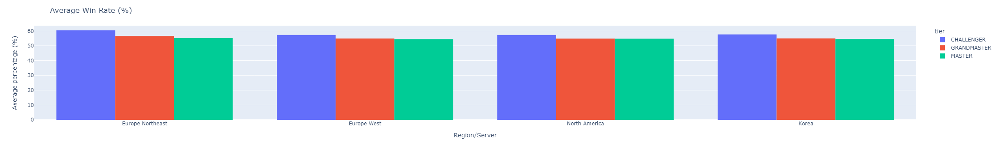

In [7]:
win_rate = px.histogram(tft, x='regionName', y='winRate', color='tier', barmode='group', histfunc='avg')
win_rate.update_layout(title_text="Average Win Rate (%)", yaxis=dict(title='Average percentage (%)'), xaxis=dict(title='Region/Server'))
win_rate.show()

## Does playing more games help me get there?
My next hypothesis was to try and figure out whether the amount of games influenced how good a player was and although the average game count of Challenger players is higher than that of Grandmasters, there are still a substantial amount of players that have the same amount of games played, but the difference in points is very noticeable.
In the scatter plot graph below there is a group of Challenger players that have somewhere between 200-400 matches played that also have a very high amount of points putting them far above any other player with the same amount of games that is not in the Challenger tier.

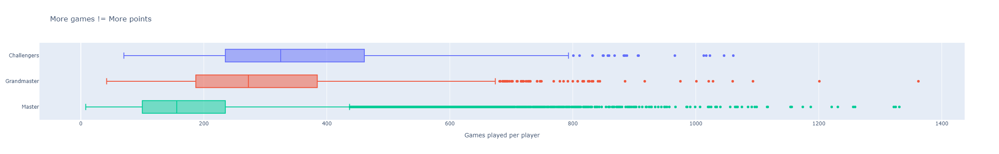

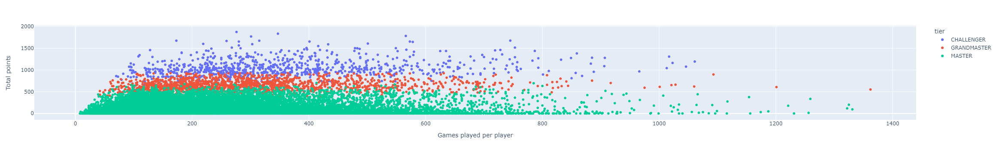

In [8]:
fig_matches = go.Figure()

fig_matches.add_trace(go.Box(
    x=tft[tft["tier"] == "MASTER"].gamesPlayed,
    name="Master",
    marker_color="#00cc96"
))
fig_matches.add_trace(go.Box(
    x=tft[tft["tier"] == "GRANDMASTER"].gamesPlayed,
    name="Grandmaster",
    marker_color="#ef553b"
))
fig_matches.add_trace(go.Box(
    x=tft[tft["tier"] == "CHALLENGER"].gamesPlayed,
    name="Challengers",
    marker_color="#636efa"
))

fig_matches.update_layout(
    title='More games != More points',
    xaxis=dict(title='Games played per player'),
    showlegend=False
)

games_points = px.scatter(tft, x="gamesPlayed", y="leaguePoints", color="tier")
games_points.update_layout(xaxis=dict(title='Games played per player'), yaxis=dict(title='Total points'))

fig_matches.show()
games_points.show()

## Veteran and fresh player density areas
Below we can see 3 graphs that have some interesting information.
The first of the scatter plot graphs shows the players that have managed to win 3+ games in a row, this information is particularly relevant for players with 0 League Points, it indicates that they have just recently gotten to master and established themselves among the top of the world.
The second graph shows a group of players that have recently entered a given tier, which confirms what we had established with the previous graph and also that there is a strong competition inbetween tiers, although it is something to be expected due to the nature of the competition based off of points and percentage of players that are allowed at the top. In fact there is a strong density in the mid section of the graph, not to mention the top most value in this graph differs from that in the other graphs.
The last of these graphs shows the amount of players that have played for 100+ matches in the same tier, either establishing themselves us the top players (if they are in Challenger) or by proving they do not have what it takes to defeat their competition and go further (in case they are in Master tier).

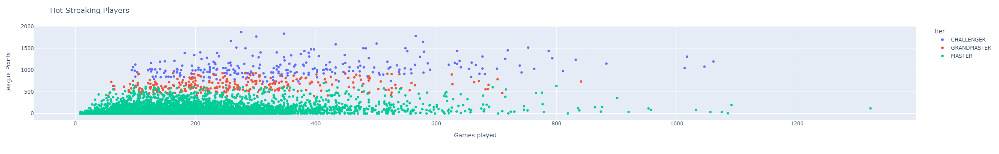

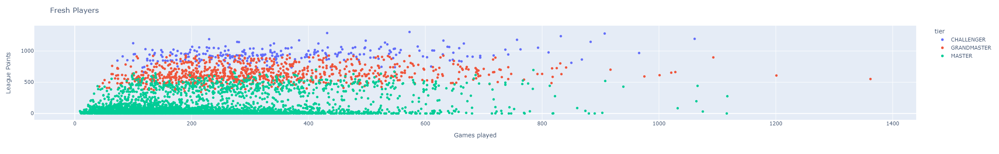

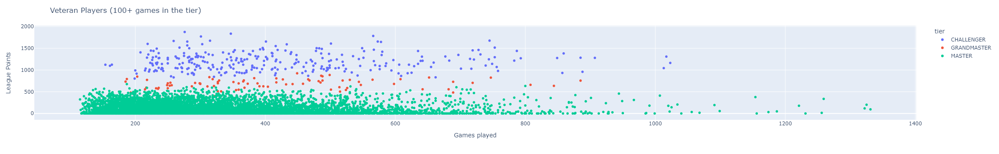

In [9]:
hot_p = tft[tft["hotStreak"] == True]
fresh_p = tft[tft["freshBlood"] == True]
vet_p = tft[tft["veteran"] == True]

built_different_vet = px.scatter(vet_p, x="gamesPlayed", y="leaguePoints", color="tier")
built_different_vet.update_layout(title='Veteran Players (100+ games in the tier)', xaxis=dict(title="Games played"), yaxis=dict(title="League Points"))

built_different_fresh = px.scatter(fresh_p, x="gamesPlayed", y="leaguePoints", color="tier")
built_different_fresh.update_layout(title='Fresh Players', xaxis=dict(title="Games played"), yaxis=dict(title="League Points"))

built_different_hot = px.scatter(hot_p, x="gamesPlayed", y="leaguePoints", color="tier")
built_different_hot.update_layout(title='Hot Streaking Players', xaxis=dict(title="Games played"), yaxis=dict(title="League Points"))

built_different_hot.show()
built_different_fresh.show()
built_different_vet.show()

## Top players are far above mid level players
Although the win rate difference among the top 3 tiers is not much, it is vastly different from that of a mid level player, according to a tracking website (https://lolchess.gg/leaderboards?mode=ranked&region=global) I would be among the top 25% players in the world, but below you will see there is a vast difference between my win rate and that of a top player, the impact is stark, when we consider that the points I would require to get to Masters is 800 and there are plenty of Master players that are that amount of points below a Challenger player without necessarily having this wide of a gap in win rate.

In [10]:
daniel = ['Daniel', 'Platinum', 'Me', -800, 11, 158, False, False, False, False, 169, 6.5]
tft_daniel = tft
if not 'Daniel' in set(tft_daniel['summonerName']):
    tft_daniel.loc[len(tft_daniel)] = daniel

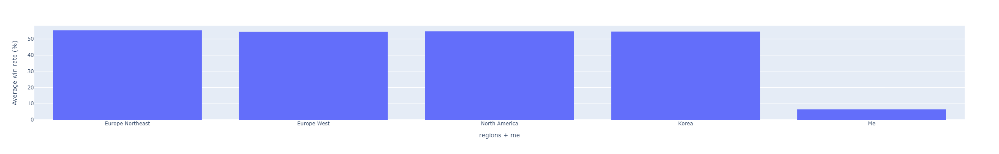

In [11]:
daniel_win_rate = px.histogram(tft_daniel, x='regionName', y='winRate', histfunc='avg')
daniel_win_rate.update_layout(xaxis=dict(title='regions + me'), yaxis=dict(title='Average win rate (%)'))
daniel_win_rate.show()